In [1]:
import cv2 as cv

from surya.detection import batch_text_detection
from surya.model.detection.model import load_model, load_processor
from surya.layout import batch_layout_detection
from surya.settings import settings

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

import torch
import clip
import tqdm



In [2]:

def draw_polygons(image, polygons, color=(255, 0, 0), thickness=2):
    """
    Draws polygons on the given image.

    Parameters:
    image (numpy.ndarray): The input image on which polygons are to be drawn.
    polygons (list of list of list of int): A list of polygons, where each polygon is represented
                                            as a list of points, and each point is a list of two integers [x, y].
    color (tuple of int, optional): Color of the polygon lines in BGR format. Default is green (0, 255, 0).
    thickness (int, optional): Thickness of the polygon lines. Default is 2.

    Returns:
    numpy.ndarray: The image with polygons drawn on it.
    """
    # Make a copy of the image to avoid modifying the original one
    output_image = image.copy()

    # Iterate over each polygon
    for polygon in polygons:
        # Convert the list of points to a numpy array of shape (n, 1, 2), required by polylines
        pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
        # Draw the polygon on the image
        cv.drawContours(output_image, [pts], -1, color, thickness)

    return output_image



def extract_bounding_box(polygon):
    """
    Extracts the bounding box (x, y, w, h) from a given polygon.

    Parameters:
    polygon (list of list of int): A list of points representing the polygon.

    Returns:
    tuple: A tuple containing (x, y, w, h) which represents the bounding box.
    """
    # Convert the polygon points to a numpy array for easier manipulation
    pts = np.array(polygon)

    # Extract x and y coordinates
    x_coords = pts[:, 0]
    y_coords = pts[:, 1]

    # Calculate the minimum and maximum x and y values
    x_min = np.min(x_coords)
    x_max = np.max(x_coords)
    y_min = np.min(y_coords)
    y_max = np.max(y_coords)

    # Calculate the width and height
    w = x_max - x_min
    h = y_max - y_min

    return x_min, y_min, w, h


def generate_polygon(x, y, w, h):
    """
    Generates a polygon (rectangle) given the bounding box parameters (x, y, w, h).

    Parameters:
    x (int): The x-coordinate of the top-left corner of the bounding box.
    y (int): The y-coordinate of the top-left corner of the bounding box.
    w (int): The width of the bounding box.
    h (int): The height of the bounding box.

    Returns:
    list of list of int: A list of points representing the polygon (rectangle).
    """
    # Define the four corners of the rectangle
    polygon = [
        [x, y],         # Top-left corner
        [x + w, y],     # Top-right corner
        [x + w, y + h], # Bottom-right corner
        [x, y + h]      # Bottom-left corner
    ]
    
    return polygon


In [3]:
def calculate_center(box):
    x, y, w, h = box
    return (x + w / 2, y + h / 2)

def are_horizontally_aligned(box1, box2, confidence_interval):
    _, y1_center = calculate_center(box1)
    _, y2_center = calculate_center(box2)
    return abs(y1_center - y2_center) <= confidence_interval

def merge_boxes(box1, box2):
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    new_x = min(x1, x2)
    new_y = min(y1, y2)
    new_w = max(x1 + w1, x2 + w2) - new_x
    new_h = max(y1 + h1, y2 + h2) - new_y
    return (new_x, new_y, new_w, new_h)

def merge_horizontally_aligned_bounding_boxes(boxes, confidence_interval):
    merged = True
    while merged:
        merged = False
        new_boxes = []
        skip_indices = set()
        
        for i in range(len(boxes)):
            if i in skip_indices:
                continue
            box1 = boxes[i]
            merged_box = box1
            
            for j in range(i + 1, len(boxes)):
                if j in skip_indices:
                    continue
                box2 = boxes[j]
                
                if are_horizontally_aligned(merged_box, box2, confidence_interval):
                    merged_box = merge_boxes(merged_box, box2)
                    skip_indices.add(j)
                    merged = True
            
            new_boxes.append(merged_box)
        
        boxes = new_boxes
    
    return boxes




In [4]:
IMAGE_PATH = "../data/CED/SFLL/1889/050000120052048,0099.jpg"
image = Image.open(IMAGE_PATH)


## Layout Extraction

In [5]:
def create_visual_label(patch, output_argmax):
    
    zeros = np.zeros_like(patch)
    # index = 2 if output_argmax else 0
    zeros[:, :, output_argmax] = 255
    
    return zeros

def segment_image(image, M, N, queries, return_sep = False):
    # Tiles for segmentation, recomended: word-shaped
    tiles = [image[x:x+M,y:y+N] for x in range(0,image.shape[0],M) for y in range(0,image.shape[1],N)]
    indices = [(x, x+M, y, y+N) for x in range(0,image.shape[0],M) for y in range(0,image.shape[1],N)]
    
    # CLIP SetUp
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model, preprocess = clip.load("ViT-B/32", device=device)

    text = clip.tokenize(queries).to(device)
    
    canvas = np.zeros_like(image)
    
    for (x, w, y, h), tile in tqdm.tqdm(zip(indices, tiles)):
        with torch.no_grad():
            tile_pil = Image.fromarray(tile)
            image_input = preprocess(tile_pil).unsqueeze(0).to(device)

            logits_per_image, logits_per_text = model(image_input, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            visual_label = create_visual_label(tile, probs.argmax()) * probs.max()
            canvas[x:w, y:h, :] = visual_label
        
    canvas_uint = canvas.astype(np.uint8) / 255
    if return_sep: return canvas_uint, image/255
    
    masked = canvas_uint * 0.5 + (image / 255) * 0.5
    
    return masked

In [17]:
model = load_model(checkpoint=settings.LAYOUT_MODEL_CHECKPOINT)
processor = load_processor(checkpoint=settings.LAYOUT_MODEL_CHECKPOINT)
det_model = load_model()
det_processor = load_processor()
line_predictions = batch_text_detection([image], det_model, det_processor)
layout_predictions = batch_layout_detection([image], model, processor, line_predictions)

Loaded detection model vikp/surya_layout3 on device cuda with dtype torch.float16


Loaded detection model vikp/surya_det3 on device cuda with dtype torch.float16


Detecting bboxes: 100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


In [18]:
layout_predictions[0].image_bbox

[0.0, 0.0, 1587.0, 1218.0]

In [6]:
#IMAGE_PATH = "../data/Documents/SFLL/1945/050000120052065,0003.jpg"

image = Image.open(IMAGE_PATH).convert("RGB")

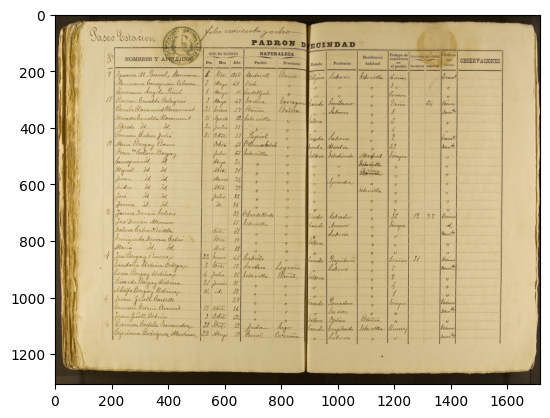

In [7]:
plt.imshow(image)

In [21]:
np.array(image).shape

(1218, 1587, 3)

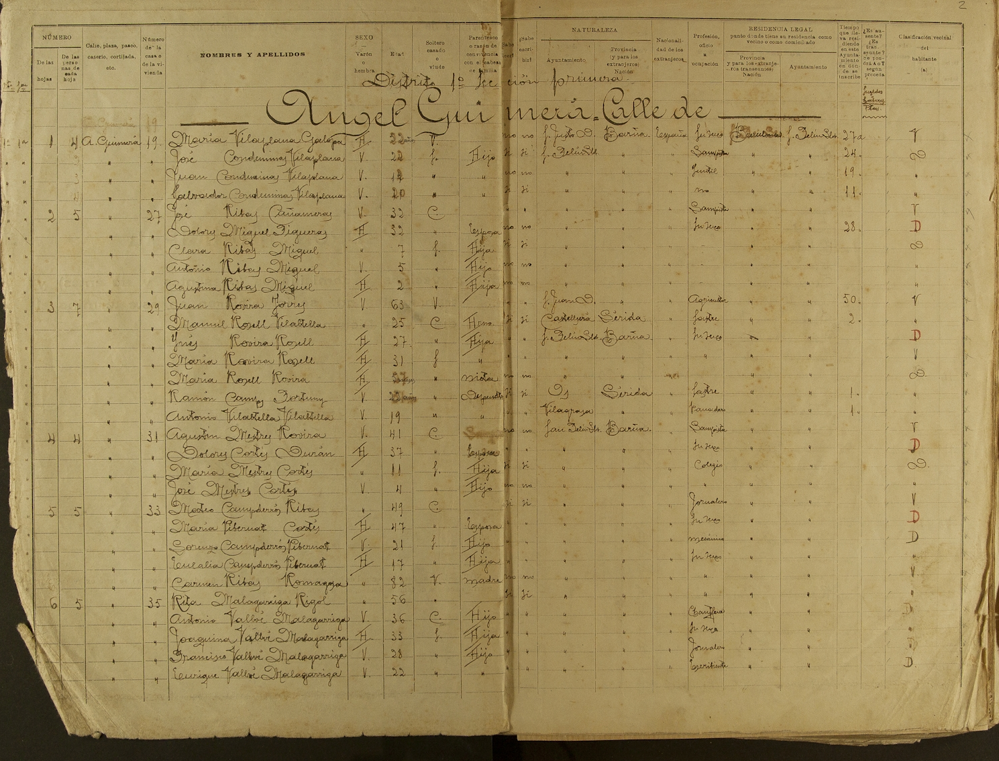

In [22]:
: (X: 240, Y: 70)
Bottom-right corner: (X: 410, Y: 110)

x, y, w, h = #layout_predictions[0].bboxes[0].bbox
#image = Image.open(IMAGE_PATH)
img = np.array(image)
#cropping
cropped_image = img[y:y+h, x:x+w]
cropped_image = Image.fromarray(cropped_image)
cropped_image

In [23]:

cropped_image = image
model, processor = load_model(), load_processor()

# predictions is a list of dicts, one per image
predictions = batch_text_detection([cropped_image], model, processor)

Loaded detection model vikp/surya_det3 on device cuda with dtype torch.float16


Detecting bboxes: 100%|██████████| 1/1 [00:00<00:00,  5.48it/s]


In [24]:
test = predictions[0]

print(test.bboxes)

[PolygonBox(polygon=[[1273, 106], [1341, 113], [1338, 128], [1270, 120]], confidence=0.7063227891921997, bbox=[1273, 106, 1341, 128]), PolygonBox(polygon=[[1136, 110], [1243, 110], [1243, 122], [1136, 122]], confidence=0.8769981861114502, bbox=[1136, 110, 1243, 122]), PolygonBox(polygon=[[870, 110], [948, 110], [948, 124], [870, 124]], confidence=0.8038374185562134, bbox=[870, 110, 948, 124]), PolygonBox(polygon=[[87, 122], [136, 122], [136, 134], [87, 134]], confidence=0.747423529624939, bbox=[87, 122, 136, 134]), PolygonBox(polygon=[[550, 121], [587, 121], [587, 136], [550, 136]], confidence=0.7723303437232971, bbox=[550, 121, 587, 136]), PolygonBox(polygon=[[719, 121], [772, 121], [772, 136], [719, 136]], confidence=0.7296938896179199, bbox=[719, 121, 772, 136]), PolygonBox(polygon=[[1104, 113], [1345, 125], [1342, 158], [1102, 146]], confidence=0.7681937217712402, bbox=[1104, 113, 1345, 158]), PolygonBox(polygon=[[793, 124], [834, 124], [834, 139], [793, 139]], confidence=0.7357011

In [25]:
bboxs = [i.polygon for i in test.bboxes]

In [26]:
out = draw_polygons(np.array(cropped_image)/255, bboxs)

In [27]:
image_uint8 = (out * 255).astype(np.uint8)
imagee = Image.fromarray(image_uint8)

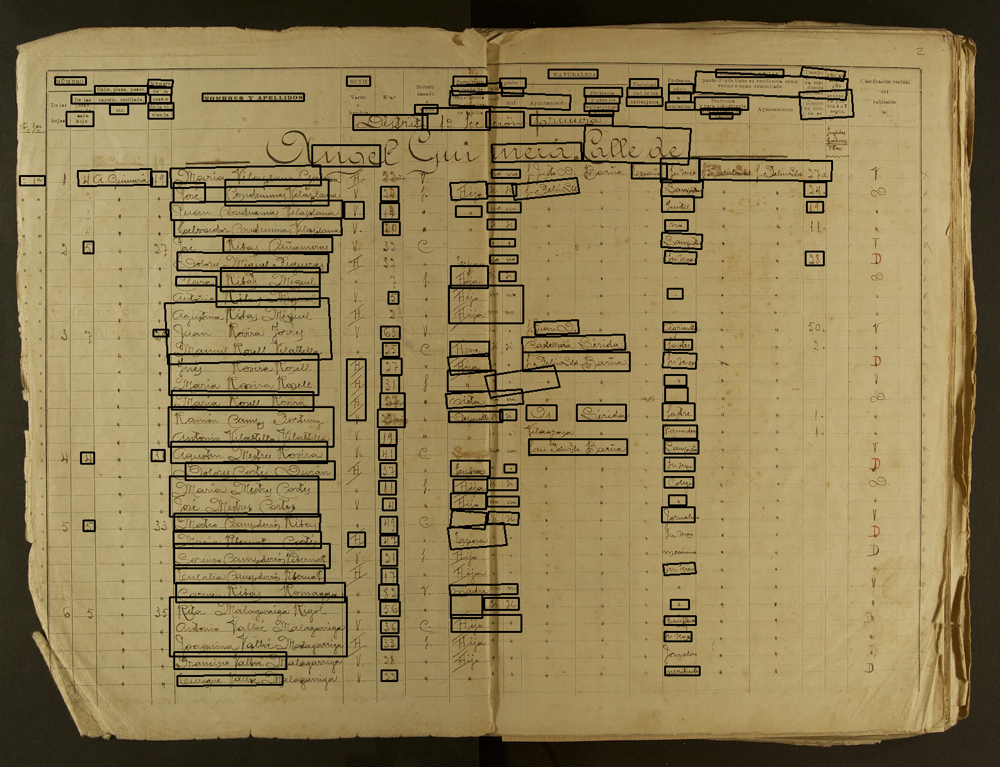

In [28]:
imagee

In [29]:
bboxes = [extract_bounding_box(i) for i in bboxs]
#bboxes = [i.bbox for i in test.bboxes]

In [30]:
print(sorted(bboxes, key=lambda x: x[0]))

[(31, 279, 40, 15), (87, 122, 49, 12), (105, 177, 43, 23), (113, 150, 118, 14), (123, 268, 118, 27), (128, 718, 21, 18), (132, 383, 16, 19), (132, 826, 18, 17), (150, 136, 84, 12), (174, 166, 29, 15), (234, 126, 40, 12), (235, 139, 37, 11), (235, 163, 40, 12), (235, 174, 40, 14), (238, 150, 33, 14), (239, 272, 26, 24), (240, 714, 21, 18), (243, 523, 24, 11), (261, 473, 265, 105), (267, 646, 262, 63), (268, 562, 237, 65), (269, 756, 236, 64), (269, 948, 281, 94), (270, 262, 239, 36), (270, 318, 273, 31), (271, 701, 248, 34), (272, 620, 225, 32), (275, 290, 50, 31), (275, 844, 234, 26), (276, 347, 266, 28), (276, 815, 232, 28), (276, 863, 247, 39), (276, 897, 239, 29), (276, 1035, 178, 27), (279, 439, 64, 14), (279, 925, 268, 31), (281, 400, 240, 32), (281, 1071, 167, 18), (294, 732, 237, 30), (321, 148, 161, 12), (343, 455, 164, 32), (350, 425, 157, 37), (354, 376, 173, 24), (357, 285, 164, 41), (495, 230, 108, 34), (546, 320, 31, 27), (550, 121, 37, 15), (550, 570, 30, 97), (552, 845, 

In [31]:
x_variation = [i[0] for i in sorted(bboxes, key=lambda x: x[0])]


In [32]:


extract_xaxis_variance = [i for i in sorted(bboxes, key=lambda x: x[0]) if i[0] <= np.std(x_variation)]


In [33]:
test = [generate_polygon(*i) for i in sorted(bboxes, key=lambda x: x[0]) if i[0] < np.std(x_variation)]

In [34]:
new_out = draw_polygons(np.array(cropped_image)/255, polygons=test)

In [35]:
image_uint8 = (new_out * 255).astype(np.uint8)
imagee2 = Image.fromarray(image_uint8)

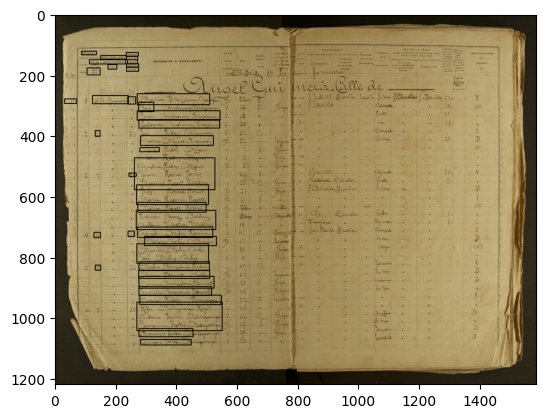

In [36]:
plt.imshow(imagee2)

In [37]:
confidence_interval = 20  # Adjust the confidence interval as needed
merged_boxes = merge_horizontally_aligned_bounding_boxes(sorted(extract_xaxis_variance, key=lambda x: x[1]), confidence_interval=confidence_interval)

print("Merged Bounding Boxes:", len(merged_boxes))

Merged Bounding Boxes: 24


In [38]:
test = [generate_polygon(*i) for i in merged_boxes]

In [39]:
new_out = draw_polygons(np.array(cropped_image)/255, polygons=test)

In [40]:
image_uint8 = (new_out * 255).astype(np.uint8)
imagee2 = Image.fromarray(image_uint8)

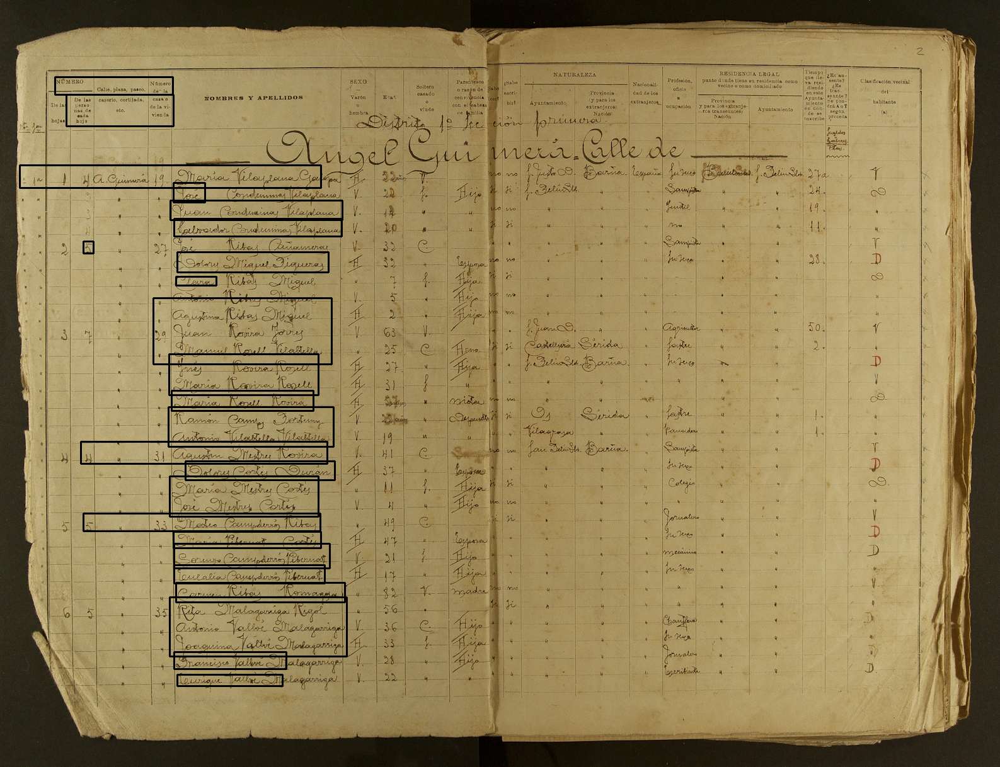

In [41]:
imagee2

In [42]:
import copy
true_test = copy.copy(merged_boxes)
true_test = sorted(merged_boxes, key=lambda x: x[1])


mena_distances_bbox = {}

for bbox_idx in range(len(true_test) - 1):
    x_act, y_act, w_act, h_act =  true_test[bbox_idx]
    x_nex, y_next, w_next, h_next = true_test[bbox_idx+1]

    a = [x_act, y_act, w_act, h_act]
    b = [x_nex, y_next, w_next, h_next]

    bottom_line = y_act + h_act
    next_top_line = y_next
    mena_distances_bbox[(str(a), str(b))] = abs((y_act + h_act) - y_next)
    print(a, b)
    print(abs((y_act + h_act) - y_next))

mean_consecutive_distances = np.mean(list(mena_distances_bbox.values()))
std_consecutive_distances = np.std(list(mena_distances_bbox.values()))



print((mean_consecutive_distances))
print((std_consecutive_distances))


[87, 122, 187, 28] [105, 150, 170, 50]
0
[105, 150, 170, 50] [31, 262, 478, 36]
62
[31, 262, 478, 36] [275, 290, 50, 31]
8
[275, 290, 50, 31] [270, 318, 273, 31]
3
[270, 318, 273, 31] [276, 347, 266, 28]
2
[276, 347, 266, 28] [132, 383, 16, 19]
8
[132, 383, 16, 19] [281, 400, 240, 32]
2
[281, 400, 240, 32] [279, 439, 64, 14]
7
[279, 439, 64, 14] [243, 473, 283, 105]
20
[243, 473, 283, 105] [268, 562, 237, 65]
16
[268, 562, 237, 65] [272, 620, 225, 32]
7
[272, 620, 225, 32] [267, 646, 262, 63]
6
[267, 646, 262, 63] [128, 701, 391, 35]
8
[128, 701, 391, 35] [294, 732, 237, 30]
4
[294, 732, 237, 30] [269, 756, 236, 64]
6
[269, 756, 236, 64] [132, 815, 376, 28]
5
[132, 815, 376, 28] [275, 844, 234, 26]
1
[275, 844, 234, 26] [276, 863, 247, 39]
7
[276, 863, 247, 39] [276, 897, 239, 29]
5
[276, 897, 239, 29] [279, 925, 268, 31]
1
[279, 925, 268, 31] [269, 948, 281, 94]
8
[269, 948, 281, 94] [276, 1035, 178, 27]
7
[276, 1035, 178, 27] [281, 1071, 167, 18]
9
8.782608695652174
12.18679442725191

In [43]:
extract_yaxis_variance = [eval(ii) for i, j in mena_distances_bbox.items() for ii in i if j < mean_consecutive_distances+ 1.2*std_consecutive_distances]

filtered = {tuple(i) for i in extract_yaxis_variance}

In [44]:
filtered_by_area = [generate_polygon(*i) for i in sorted(filtered, key=lambda x: x[1])]


In [45]:
merged_out = draw_polygons(np.array(cropped_image)/255, polygons=filtered_by_area)

In [46]:
image_uint8 = (merged_out * 255).astype(np.uint8)
merged = Image.fromarray(image_uint8)

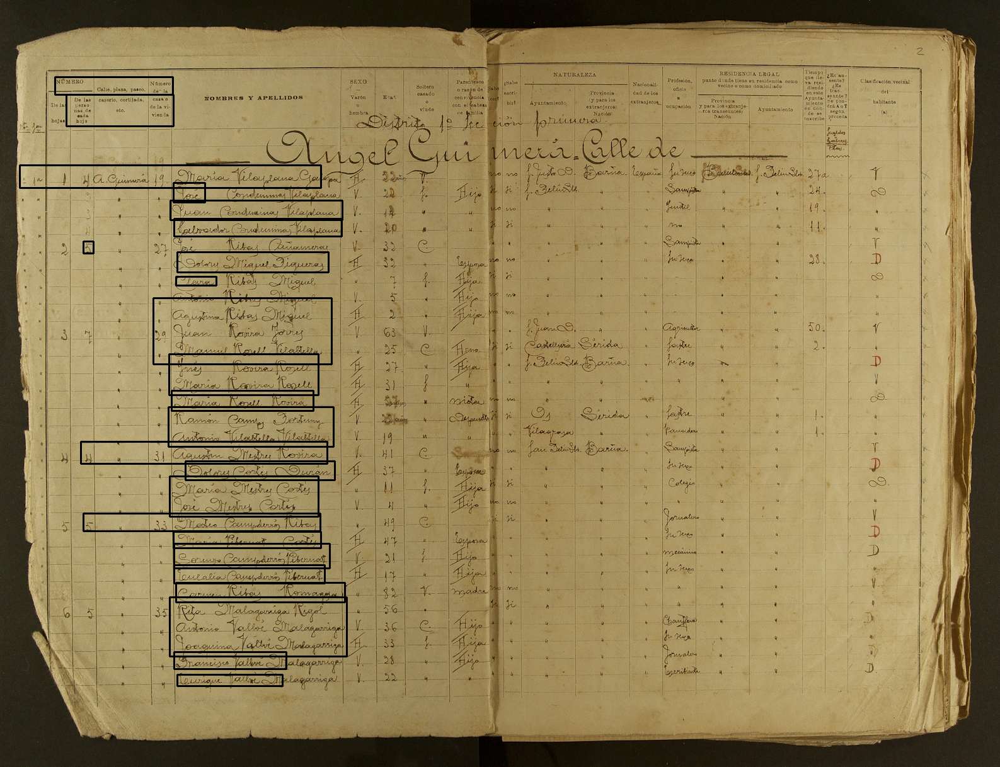

In [47]:
merged

In [38]:
ordered_merged_boxes = sorted(filtered, key=lambda x: x[1])

def get_lines_from_bboxes(ordered_merged_boxes:list[list[int, int, int, int]])-> list[list[int, int, int, int]]:
        
    lines = []
    for bbox_idx in range(len(ordered_merged_boxes)-1):
        x_act, y_act, w_act, h_act =  ordered_merged_boxes[bbox_idx]
        x_nex, y_next, w_next, h_next = ordered_merged_boxes[bbox_idx+1]

        bottom_line = y_act + h_act
        next_top_line = y_next
        if bbox_idx == 0 and (abs(bottom_line - next_top_line) > 20):
            continue

        lines.append([0, y_act , np.array(image).shape[1], h_act])

        if (bbox_idx+1) == (len(ordered_merged_boxes) -1) and  (abs(bottom_line - next_top_line) < 20):
            area_previous = y_act * w_act
            area_next = y_next * w_next
            if not area_previous > 3*area_next:

                lines.append([0, y_next , np.array(image).shape[1], h_act])


    return lines



        
lines = get_lines_from_bboxes(ordered_merged_boxes)
lines = get_lines_from_bboxes(ordered_merged_boxes=lines)
    

In [39]:
print(lines)

[[0, 208, 1603, 29], [0, 236, 1603, 26], [0, 261, 1603, 26], [0, 288, 1603, 26], [0, 317, 1603, 24], [0, 398, 1603, 27], [0, 427, 1603, 21], [0, 451, 1603, 26], [0, 479, 1603, 33], [0, 506, 1603, 27], [0, 532, 1603, 27], [0, 561, 1603, 26], [0, 589, 1603, 33], [0, 617, 1603, 34], [0, 645, 1603, 26], [0, 670, 1603, 28], [0, 700, 1603, 24], [0, 725, 1603, 32], [0, 752, 1603, 28], [0, 779, 1603, 30], [0, 808, 1603, 26], [0, 835, 1603, 24], [0, 864, 1603, 23], [0, 890, 1603, 33], [0, 917, 1603, 23], [0, 945, 1603, 24], [0, 969, 1603, 26], [0, 998, 1603, 24], [0, 1025, 1603, 35], [0, 1052, 1603, 25], [0, 1081, 1603, 25]]


In [40]:
print(len(lines))
lines_merged = [generate_polygon(*i) for i in sorted(lines, key=lambda x: x[1])]
lines_out = draw_polygons(np.array(cropped_image)/255, polygons=lines_merged)
image_uint8 = (lines_out * 255).astype(np.uint8)
lines_out = Image.fromarray(image_uint8)

31


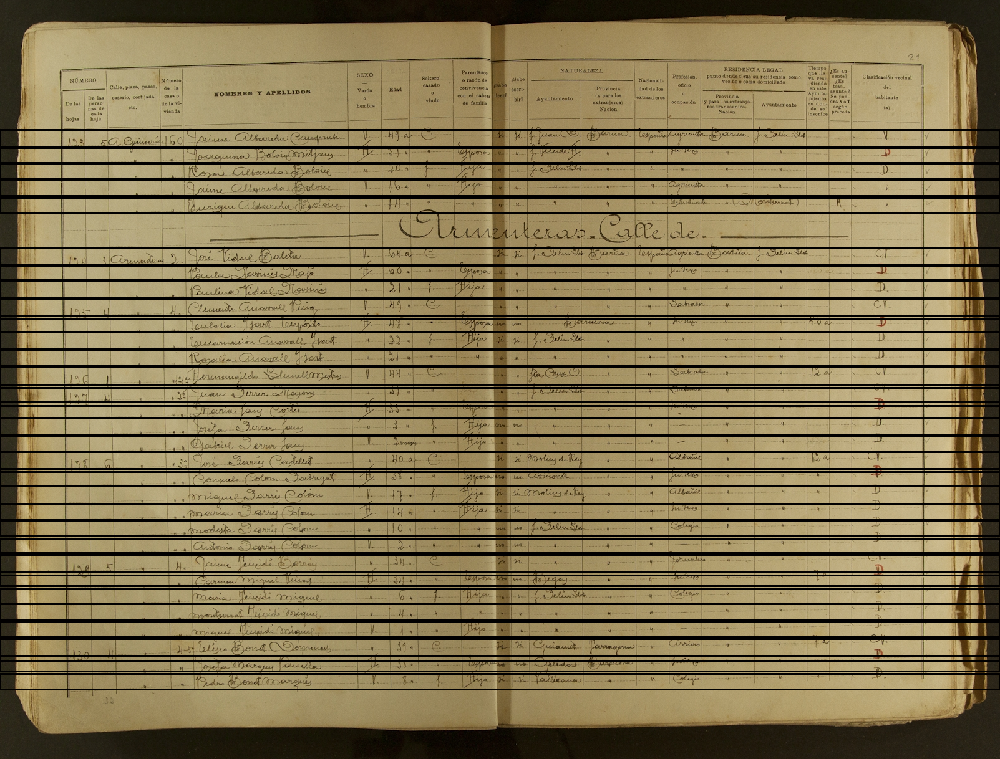

In [41]:
lines_out

In [42]:
x, y, w, h = sorted(lines, key=lambda x: x[1])[0]

In [43]:
Image.fromarray(np.array(cropped_image)[y:y+h, x:x+w])

In [44]:
example = np.array(cropped_image)[y:y+h, x:x+w]

In [45]:
flines = sorted(lines, key=lambda x: x[1])
flines

[[0, 208, 1603, 29],
 [0, 236, 1603, 26],
 [0, 261, 1603, 26],
 [0, 288, 1603, 26],
 [0, 317, 1603, 24],
 [0, 398, 1603, 27],
 [0, 427, 1603, 21],
 [0, 451, 1603, 26],
 [0, 479, 1603, 33],
 [0, 506, 1603, 27],
 [0, 532, 1603, 27],
 [0, 561, 1603, 26],
 [0, 589, 1603, 33],
 [0, 617, 1603, 34],
 [0, 645, 1603, 26],
 [0, 670, 1603, 28],
 [0, 700, 1603, 24],
 [0, 725, 1603, 32],
 [0, 752, 1603, 28],
 [0, 779, 1603, 30],
 [0, 808, 1603, 26],
 [0, 835, 1603, 24],
 [0, 864, 1603, 23],
 [0, 890, 1603, 33],
 [0, 917, 1603, 23],
 [0, 945, 1603, 24],
 [0, 969, 1603, 26],
 [0, 998, 1603, 24],
 [0, 1025, 1603, 35],
 [0, 1052, 1603, 25],
 [0, 1081, 1603, 25]]

## Handwritten / Printed Segmentation

In [46]:
M = 224
N = 96
example = np.array(cropped_image)
tiles = [example[x:x+M,y:y+N] for x in range(0,example.shape[0],M) for y in range(0,example.shape[1],N)]
indices = [(x, x+M, y, y+N) for x in range(0,example.shape[0],M) for y in range(0,example.shape[1],N)]

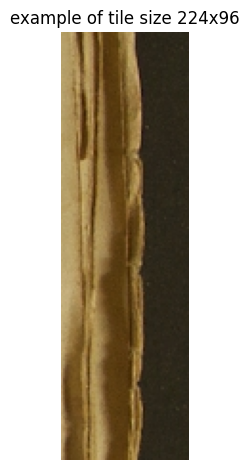

In [47]:
plt.imshow(tiles[50])
plt.title(f'example of tile size {M}x{N}')
plt.axis('off')
plt.tight_layout()
plt.show()

260it [00:19, 13.20it/s]


(1218, 1603, 3)
983394.8882352944
777636.0019607845
376005.6862745096


14it [00:01, 12.21it/s]

169it [00:12, 13.21it/s]


(1218, 1603, 3)
1097631.9392156855
679902.3549019606
366196.92941176455


104it [00:08, 12.93it/s]


(1218, 1603, 3)
1001383.0921568625
753697.5549019607
375049.4117647058


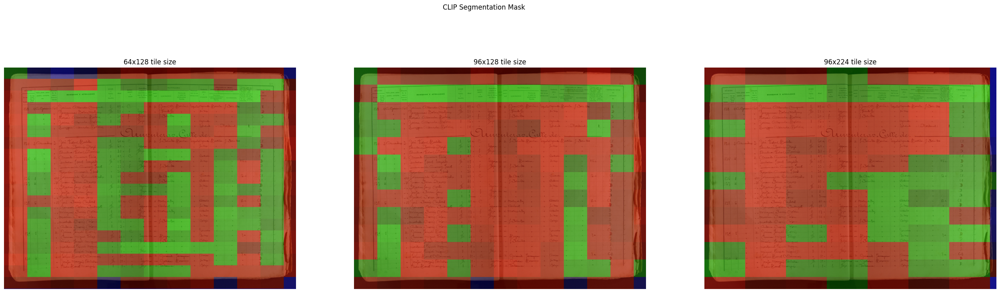

In [48]:
resolutions_to_try = [(64, 128), (96, 128), (96, 224)]#, (224, 96)]#, (64, 64)]
queries = ['A piece of an old handwritten document with pen or pencil .',
            'A piece of an old typewritted document with typewritting machine.',# document with typewritting machine.',
            'An empty  document with.']

fig, axs = plt.subplots(ncols=len(resolutions_to_try), figsize = (32, len(resolutions_to_try) * 3))
for num, (M, N) in enumerate(resolutions_to_try):
    axs[num].title.set_text(f'{M}x{N} tile size')
    masked = segment_image(np.array(example), M, N, queries)
    print(masked.shape)
    print(np.sum(masked[:,:,0]))
    print(np.sum(masked[:,:,1]))
    print(np.sum(masked[:,:,2]))
    axs[num].imshow(
        masked
    )
    axs[num].axis('off')
fig.suptitle('CLIP Segmentation Mask')
plt.show()

31


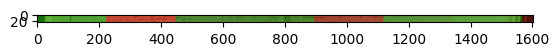

In [49]:
flines = sorted(lines, key=lambda x: x[1])

print(len(flines))
final_filtered_lines = []
for line_bbox in flines:
    x,y,w,h = line_bbox
    plt.imshow( np.array(masked)[y:y+h,x:x+w,:])
    typewritting_sum = np.sum(masked[y:y+h,x:x+w,1])
    handwritten_sum = np.sum(masked[y:y+h,x:x+w,0])


    if handwritten_sum > typewritting_sum + (typewritting_sum*0.1):
        final_filtered_lines.append(line_bbox)

In [50]:
print(len(final_filtered_lines
))

23


In [51]:
flines == final_filtered_lines

False

In [52]:
print(len(flines))
lines_merged = [generate_polygon(*i) for i in sorted(final_filtered_lines, key=lambda x: x[1])]
lines_out = draw_polygons(np.array(cropped_image)/255, polygons=lines_merged)
image_uint8 = (lines_out * 255).astype(np.uint8)
lines_out = Image.fromarray(image_uint8)

31


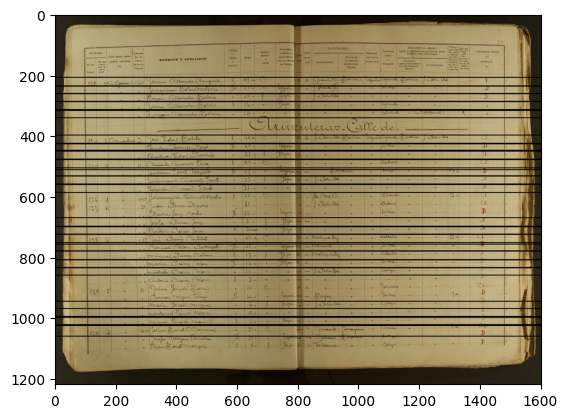

In [53]:
plt.imshow(lines_out)